# Coursework 2: Generative Models

## Instructions

Please submit on CATe two zip files:

*CW2.zip* containing the following:
1. A version of this notebook containing your answers. Write your answers in the cells below each question. **Please deliver the notebook including the outputs of the cells below.**
2. Your trained VAE model as *VAE_model.pth*

*GAN.zip* containing your trained Generator and Discriminator: *DCGAN_model_D.pth and DCGAN_model_G.pth*

Please avoid using markdown headings (# ## etc.) as these will affect the ToC. Instead use html headings if you want emphasis.

Similarly to the previous coursework, we recommend that you use Google Colaboratory in order to train the required networks.

TAs will run a testing cell (at the end of this notebook), so you are required to copy your transform and denorm functions to a cell near the bottom of the document (it is demarkated).

<font color="blue">**The deadline for submission is 19:00, Thursday 19th February, 2021** </font>

## Setting up working environment

For this coursework you, will need to train a large network, therefore we recommend you work with Google Colaboratory, which provides free GPU time. You will need a Google account to do so.

Please log in to your account and go to the following page: https://colab.research.google.com. Then upload this notebook.

For GPU support, go to "Edit" -> "Notebook Settings", and select "Hardware accelerator" as "GPU".

You will need to install pytorch and import some utilities by running the following cell:

In [2]:
!pip install -q torch torchvision altair matplotlib pandas
!git clone -q https://github.com/afspies/icl_dl_cw2_utils
from icl_dl_cw2_utils.utils.plotting import plot_tsne


You should consider upgrading via the 'pip install --upgrade pip' command.
fatal: destination path 'icl_dl_cw2_utils' already exists and is not an empty directory.


## Introduction

For this coursework, you are asked to implement two commonly used generative models:
1. A **Variational Autoencoder (VAE)**
2. A **Deep Convolutional Generative Adversarial Network (DCGAN)**

For the first part you will the MNIST dataset https:content/en.wikipedia.org/wiki/MNIST_database and for the second the CIFAR-10 (https://www.cs.toronto.edu/~kriz/cifar.html).

Each part is worth 50 points. 

The emphasis of both parts lies in understanding how the models behave and learn, however, some points will be available for getting good results with your GAN (though you should not spend too long on this).

# Part 1 - Variational Autoencoder

## Part 1.1 (25 points)
**Your Task:**

a. Implement the VAE architecture with accompanying hyperparameters. Experiment with Feedforward and Convolutional Layers to see which gives better results.

b. Design an appropriate loss function and train the model.


In [11]:
import os
import numpy as np
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, sampler
from torchvision import datasets, transforms
from torchvision.utils import save_image, make_grid
import torch.nn.functional as F
import matplotlib.pyplot as plt
from torch.autograd import Variable

def show(img):
    npimg = img.cpu().numpy()
    plt.imshow(np.transpose(npimg, (1,2,0)))

if not os.path.exists('/storage/icl_dl_cw2/CW_VAE/'):
    os.makedirs('/storage/icl_dl_cw2/CW_VAE/')

# We set a random seed to ensure that your results are reproducible.
if torch.cuda.is_available():
    torch.backends.cudnn.deterministic = True
torch.manual_seed(0)

GPU = True # Choose whether to use GPU
if GPU:
    device = torch.device("cuda"  if torch.cuda.is_available() else "cpu")
else:
    device = torch.device("cpu")
print(f'Using {device}')

Using cuda


---
## Part 1.1a: Implement VAE (25 Points)
###Hyper-parameter selection


In [12]:
# Necessary Hyperparameters 
num_epochs = 20
learning_rate = 0.001
batch_size = 64
latent_dim = 10 # Choose a value for the size of the latent space

# Additional Hyperparameters 

n_hidden = 400

# (Optionally) Modify transformations on input
transform = transforms.Compose([
    transforms.ToTensor(),
])

# (Optionally) Modify the network's output for visualizing your images
def denorm(x):
    return x
#def denorm(x):
 #   out = (x + 1) / 2
 #   return out.clamp(0, 1)

### Data loading


In [13]:
train_dat = datasets.MNIST(
    "data/", train=True, download=True, transform=transform
)
test_dat = datasets.MNIST("data/", train=False, transform=transform)

loader_train = DataLoader(train_dat, batch_size, shuffle=True)
loader_test = DataLoader(test_dat, batch_size, shuffle=False)

# Don't change 
sample_inputs, _ = next(iter(loader_test))
fixed_input = sample_inputs[:32, :, :, :]
save_image(fixed_input, '/storage/icl_dl_cw2/CW_VAE/image_original.png')

### Model Definition

<figure>
  <img src="https://blog.bayeslabs.co/assets/img/vae-gaussian.png" style="width:60%">
  <figcaption>
    Fig.1 - VAE Diagram (with a Guassian prior), taken from <a href="https://blog.bayeslabs.co/2019/06/04/All-you-need-to-know-about-Vae.html">1</a>.
  </figcaption>
</figure>


You will need to define:
* The hyperparameters
* The constructor
* encode
* reparametrize
* decode
* forward



Hints:
- It is common practice to encode the log of the variance, rather than the variance
- You might try using BatchNorm

In [14]:
# *CODE FOR PART 1.1a IN THIS CELL*

class VAE(nn.Module):
    def __init__(self, latent_dim):
        super(VAE, self).__init__()
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################
        # INITIAL ATTEMPT AT A LINEAR NETWORK
        
        #self.enc1 = nn.Linear(in_features=784, out_features=400)
        #self.enc2 = nn.Linear(in_features=400, out_features=latent_dim)
        #self.enc3 = nn.Linear(in_features=400, out_features=latent_dim)
        
        #self.dec1 = nn.Linear(in_features=latent_dim, out_features= 400)
        #self.dec2 = nn.Linear(in_features= 400, out_features= 784)
        
        
        
        # CONVOLUTIONAL LAYER NETWORK
        self.kernel_size = 3
        self.channels = 16
        
        self.encode1 = nn.Sequential(nn.Conv2d(1, self.channels, self.kernel_size),
                                   nn.BatchNorm2d(self.channels),
                                   nn.ReLU(),
                                   nn.Conv2d(self.channels, self.channels*2, self.kernel_size),
                                   nn.BatchNorm2d(self.channels*2),
                                   nn.ReLU())
        
        self.encode2 = nn.Sequential(nn.Linear(self.channels*2*(28-2*(self.kernel_size-1))**2, n_hidden))
        
        self.mu_encode = nn.Linear(n_hidden, latent_dim)
        self.logvar_encode = nn.Linear(n_hidden, latent_dim)
        
        self.decode1 = nn.Sequential(nn.Linear(latent_dim, n_hidden),
                                    nn.ReLU(),
                                    nn.Linear(n_hidden, self.channels*2*(28-2*(self.kernel_size-1))**2))
        
        self.decode2 = nn.Sequential(nn.ConvTranspose2d(self.channels*2, self.channels, self.kernel_size),
                                     nn.BatchNorm2d(self.channels),
                                     nn.ReLU(),
                                     nn.ConvTranspose2d(self.channels, 1, self.kernel_size),
                                     nn.BatchNorm2d(1),
                                     nn.Sigmoid())
        
       
        #######################################################################
        #                       ** END OF YOUR CODE **
        ####################################################################### 
        
    def encode(self, x):
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################
        h1 = self.encode1(x)
        h1 = h1.view(h1.size(0), -1)
        
        h2 = self.encode2(h1)
        
        mu = self.mu_encode(h2)
        logvar = self.logvar_encode(h2)
         
        return mu, logvar
        #######################################################################
        #                       ** END OF YOUR CODE **
        ####################################################################### 
    
    def reparametrize(self, mu, logvar):
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################
        # why exp and mulitply by 0.5??
        std = torch.exp(0.5*logvar)
        eps = torch.randn_like(std)
        #eps = Variable(std.data.new(std.size()).normal_())
        
        sample = mu + (std*eps)
        return sample
        #######################################################################
        #                       ** END OF YOUR CODE **
        ####################################################################### 

    def decode(self, z):
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################
        # how does applying relu work here ?? as should be inverse relu right?
        
        h3 = self.decode1(z)
        h3 = h3.view(h3.size(0), self.channels*2, 
                     (28 - 2*(self.kernel_size-1)), (28 - 2*(self.kernel_size-1)))
        h4 = self.decode2(h3)
        
        return h4
        #######################################################################
        #                       ** END OF YOUR CODE **
        ####################################################################### 
    
    def forward(self, x):
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################
        # how do the networks know that one learns the mu and the other sigma???
        
        mu, logvar = self.encode(x)
        z = self.reparametrize(mu, logvar)
        x_ = self.decode(z)
        
        return x_, mu, logvar
        #######################################################################
        #                       ** END OF YOUR CODE **
        ####################################################################### 

model = VAE(latent_dim).to(device)
params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print("Total number of parameters is: {}".format(params))
print(model)
# optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

Total number of parameters is: 14786551
VAE(
  (encode1): Sequential(
    (0): Conv2d(1, 16, kernel_size=(3, 3), stride=(1, 1))
    (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1))
    (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
  )
  (encode2): Sequential(
    (0): Linear(in_features=18432, out_features=400, bias=True)
  )
  (mu_encode): Linear(in_features=400, out_features=10, bias=True)
  (logvar_encode): Linear(in_features=400, out_features=10, bias=True)
  (decode1): Sequential(
    (0): Linear(in_features=10, out_features=400, bias=True)
    (1): ReLU()
    (2): Linear(in_features=400, out_features=18432, bias=True)
  )
  (decode2): Sequential(
    (0): ConvTranspose2d(32, 16, kernel_size=(3, 3), stride=(1, 1))
    (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()


--- 

## Part 1.1b: Training the Model (5 Points)

### Defining a Loss
Recall the Beta VAE loss, with an encoder $q$ and decoder $p$:
$$ \mathcal{L}=\mathbb{E}_{q_\phi(z \mid X)}[\log p_\theta(X \mid z)]-\beta D_{K L}[q_\phi(z \mid X) \| p_\theta(z)]$$

In order to implement this loss you will need to think carefully about your model's outputs and the choice of prior.

There are multiple accepted solutions. Explain your design choices based on the assumptions you make regarding the distribution of your data.

* Hint: this refers to the log likelihood as mentioned in the tutorial. Make sure these assumptions reflect on the values of your input data, i.e. depending on your choice you might need to do a simple preprocessing step.

* You are encouraged to experiment with the weighting coefficient $\beta$ and observe how it affects your training

In [15]:
# *CODE FOR PART 1.1b IN THIS CELL*

def loss_function_VAE(recon_x, x, mu, logvar, beta):
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################
        #Binary Cross Entropy:
        recon_loss = F.binary_cross_entropy(recon_x.view(-1, 784), x.view(-1, 784), reduction= 'sum') 
 
        #Kullback-Leibler divergence
        KL_loss = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())
        
        #Total loss, KLD weighted by beta
        Loss = recon_loss + beta * KL_loss
 
        return recon_loss, KL_loss, Loss
 
        #######################################################################
        #                       ** END OF YOUR CODE **
        ####################################################################### 

N = len(loader_train.dataset)
M = len(loader_test.dataset)

beta = 2
 
#Create loss tensors for plotting:
train_loss_average = torch.zeros(4, num_epochs)
test_loss_average = torch.zeros(4, num_epochs)
 
for epoch in range(num_epochs):
 
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################
        #data = None # One batch
        model.train()
        #Initialise losses:
        train_loss = 0
        train_loss_BCE = 0
        train_loss_KLD = 0


 
        for batch_idx,(data, _) in enumerate(loader_train):
            data = data.to(device)
            optimizer.zero_grad()
          
            #foward pass:
            recon_batch, mu, logvar = model(data)
            recon, KLD, loss = loss_function_VAE(recon_batch, data, mu, logvar, beta)
 
            #backward pass:
            loss.backward()
            #add losses
            train_loss += loss.item()
            train_loss_BCE += recon.item()
            train_loss_KLD += KLD.item()

            optimizer.step()
 
        print('===> Training Epoch {}/{}, Train Loss:{:.4f}'.format(epoch + 1, num_epochs, train_loss /N))
 
        train_loss_average [:, epoch] = torch.tensor((epoch + 1,
                                                train_loss / N,
                                                train_loss_BCE / N,
                                                train_loss_KLD/ N)) 
                      
        
 
        model.eval()
        #Initialise losses:
        test_loss = 0
        test_loss_BCE = 0
        test_loss_KLD = 0
 
        with torch.no_grad():
            for i,(data, _) in enumerate(loader_test):
                data = data.cuda()
                recon_batch, mu, logvar = model(data)
                recon, KLD, loss = loss_function_VAE(recon_batch, data, mu, logvar, beta)
                test_loss += loss.item()
                test_loss_BCE += recon.item()
                test_loss_KLD += KLD.item()
 
            
            print('===>Testing Epoch {}/{}, Test Loss:{:.4f}'.format(epoch + 1, num_epochs, test_loss /N, test_loss_KLD /N))
            
            #fill training losses:
            test_loss_average [:, epoch] = torch.tensor((epoch + 1,
                                                  test_loss / M,
                                                  test_loss_BCE / M,
                                                  test_loss_KLD/ M)) 
              
 
        #######################################################################
        #                       ** END OF YOUR CODE **
        ####################################################################### 
        
        # save the model
        if epoch == num_epochs - 1:
            with torch.no_grad():
                torch.jit.save(torch.jit.trace(model, (data), check_trace=False),
                    '/storage/icl_dl_cw2/CW_VAE/VAE_model11.pth')

===> Training Epoch 1/20, Train Loss:530.0579
===>Testing Epoch 1/20, Test Loss:49.8441
===> Training Epoch 2/20, Train Loss:271.3369
===>Testing Epoch 2/20, Test Loss:63.9301
===> Training Epoch 3/20, Train Loss:199.5181
===>Testing Epoch 3/20, Test Loss:29.7139
===> Training Epoch 4/20, Train Loss:163.5322
===>Testing Epoch 4/20, Test Loss:24.7587
===> Training Epoch 5/20, Train Loss:147.1564
===>Testing Epoch 5/20, Test Loss:23.5121
===> Training Epoch 6/20, Train Loss:137.7767
===>Testing Epoch 6/20, Test Loss:22.4406
===> Training Epoch 7/20, Train Loss:132.4292
===>Testing Epoch 7/20, Test Loss:21.9861
===> Training Epoch 8/20, Train Loss:129.5411
===>Testing Epoch 8/20, Test Loss:21.4314
===> Training Epoch 9/20, Train Loss:127.6727
===>Testing Epoch 9/20, Test Loss:21.0934
===> Training Epoch 10/20, Train Loss:126.2488
===>Testing Epoch 10/20, Test Loss:21.1699
===> Training Epoch 11/20, Train Loss:124.9793
===>Testing Epoch 11/20, Test Loss:20.6777
===> Training Epoch 12/20, T

### Loss Explanation
Explain your choice of loss and how this relates to:

* The VAE Prior
* The output data domain
* Disentanglement in the latent space


**YOUR ANSWER**

A VAE tries to find the variational lower bound of logP(X), which in practice is good enough, as trying to find the exact distribution is often untractable. Maximizing the variational lower bound maximizes the log probability of our data by proxy. In laymans terms this means that the objective of VAE is to generate samples which are as close as possible to real ones, which is done by maximizing log(p(X)).
 


The reconstruction loss is a measure of the likelihood of the reconstructed data output at the decoder. This is necessary because the latent vector has far fewer dimensions compared to the input data, therefore some details will be lost on converting the latent vector back and this must be quantified. 

The input data to the model is a tensor which holds a batch of 64 images of size 28x28. The output data is of the exact same dimensions (output size = [64, 1, 28, 28] = input size). We reshape the both the input and output tensors to size [64, 784] and then feed then into the binary cross entropy loss function. We use binary cross entropy as we are dealing with a binary classification task here, essentially whether each pixel in the images being compared are both the same or different. 

With zero reconstruction loss, an autoencoder would perfectly reconstruct the input data. This would indicate extreme overfitting and a lack of interpretable latent features.


K-L divergence is a measure of how different a specific probability distribution is from a reference distribution. It is optimal for the distributions of the VAE to be regularized to increase the amount of overlap within the latent space. K-L divergence measures this and is added into the total loss function.

We can obtain a closed form for the K-L loss function if we choose a gaussian representation for the latent prior p(z) (P(z)= N(0,1)), which we do in this implementation. The K-L loss function defined in the code on line 11 of the above box is that closed form representation. 


There is a tradeoff between reconstruction and regularization. If we want to reduce our reconstruction error, this comes at the expense of K-L divergence or regularization. The hyperparameter β is used to keep the K-L divergence loss in check. β-VAE was first proposed by Higgins et al. (2017) as a constrained version of VAE to discover disentangled latent factors. Disentanglement constitutes the complex task of learning representations that separate the underlying structure of the world into disjoint parts of its representation.

If each variable in the inferred latent representation z is only sensitive to one single generative factor and relatively invariant to other factors, we will say this representation is disentangled or factorized. One benefit that often comes with disentangled representation is good interpretability and easy generalization to a variety of tasks.

When β > 1, it applies a stronger constraint on the latent bottleneck and limits the representation capacity of z. For some conditionally independent generative factors, keeping them disentangled is the most efficient representation. Therefore a higher β encourages more efficient latent encoding and further encourages the disentanglement. Meanwhile, a higher β may create a trade-off between reconstruction quality and the extent of disentanglement. (later on in this file I have plotted generated images with a β = 0.5 and below this further generated images using a β = 2, I will explain their differences later on in the text)

<h2>Part 1.2 (9 points)</h2>

a. Plot your loss curves

b. Show reconstructions and samples

c. Discuss your results from parts (a) and (b)

## Part 1.2a: Loss Curves (3 Points)
Plot your loss curves (6 in total, 3 for the training set and 3 for the test set): total loss, reconstruction log likelihood loss, KL loss (x-axis: epochs, y-axis: loss). If you experimented with different values of $\beta$, you may wish to display multiple plots (worth 1 point).

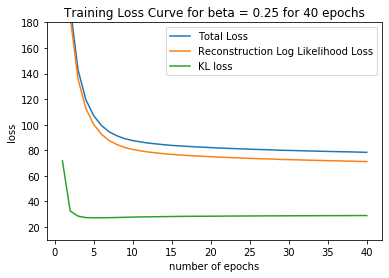

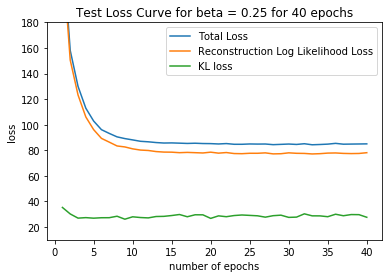

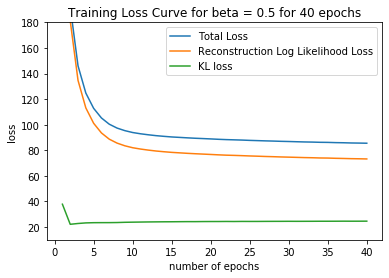

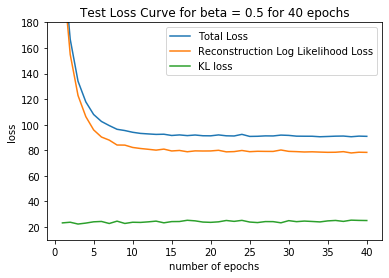

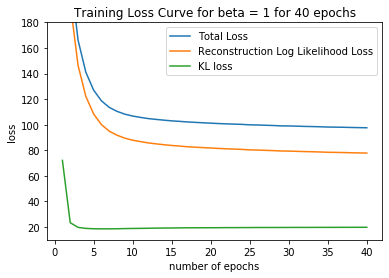

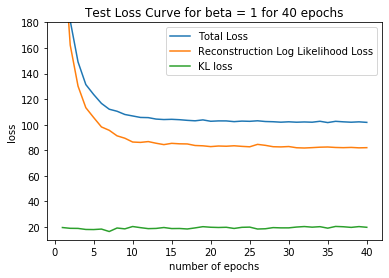

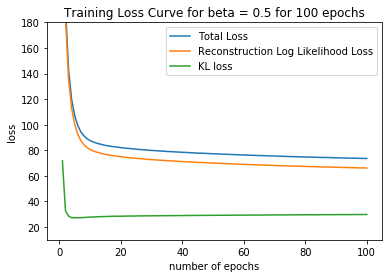

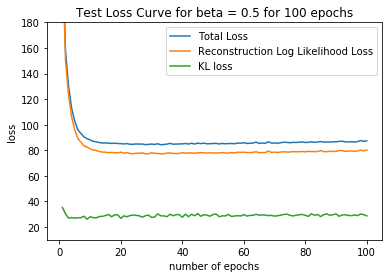

In [138]:
# *CODE FOR PART 1.2a IN THIS CELL*
import matplotlib.pyplot as plt

# TRAINING LOSS PLOT FOR BETA = 0.25
plt.plot(train_loss_average_beta_one_quarter[0, :], train_loss_average_beta_one_quarter[1, :])
plt.title('Training Loss Curve for beta = 0.25 for 40 epochs')
plt.xlabel("number of epochs")
plt.ylabel("loss")

plt.plot(train_loss_average_beta_one_quarter[0, :], train_loss_average_beta_one_quarter[2, :])
plt.plot(train_loss_average_beta_one_quarter[0, :], train_loss_average_beta_one_quarter[3, :])

plt.legend(['Total Loss', 'Reconstruction Log Likelihood Loss', 'KL loss'], loc=1)

plt.ylim(10, 180)

plt.show()


# TEST LOSS PLOT FOR BETA = 0.25
plt.plot(test_loss_average_beta_one_quarter[0, :], test_loss_average_beta_one_quarter[1, :])
plt.title('Test Loss Curve for beta = 0.25 for 40 epochs')
plt.xlabel("number of epochs")
plt.ylabel("loss")

plt.plot(test_loss_average_beta_one_quarter[0, :], test_loss_average_beta_one_quarter[2, :])
plt.plot(test_loss_average_beta_one_quarter[0, :], test_loss_average_beta_one_quarter[3, :])

plt.legend(['Total Loss', 'Reconstruction Log Likelihood Loss', 'KL loss'], loc=1)
plt.ylim(10, 180)
plt.show()





# TRAINING LOSS PLOT FOR BETA = 0.5
plt.plot(train_loss_average_beta_half[0, :], train_loss_average_beta_half[1, :])
plt.title('Training Loss Curve for beta = 0.5 for 40 epochs')
plt.xlabel("number of epochs")
plt.ylabel("loss")

plt.plot(train_loss_average_beta_half[0, :], train_loss_average_beta_half[2, :])
plt.plot(train_loss_average_beta_half[0, :], train_loss_average_beta_half[3, :])

plt.legend(['Total Loss', 'Reconstruction Log Likelihood Loss', 'KL loss'], loc=1)
plt.ylim(10, 180)
plt.show()


# TEST LOSS PLOT FOR BETA = 0.5
plt.plot(test_loss_average_beta_half[0, :], test_loss_average_beta_half[1, :])
plt.title('Test Loss Curve for beta = 0.5 for 40 epochs')
plt.xlabel("number of epochs")
plt.ylabel("loss")

plt.plot(test_loss_average_beta_half[0, :], test_loss_average_beta_half[2, :])
plt.plot(test_loss_average_beta_half[0, :], test_loss_average_beta_half[3, :])

plt.legend(['Total Loss', 'Reconstruction Log Likelihood Loss', 'KL loss'], loc=1)
plt.ylim(10, 180)
plt.show()



# TRAINING LOSS PLOT FOR BETA = 1
plt.plot(train_loss_average_beta_one[0, :], train_loss_average_beta_one[1, :])
plt.title('Training Loss Curve for beta = 1 for 40 epochs')
plt.xlabel("number of epochs")
plt.ylabel("loss")

plt.plot(train_loss_average_beta_one[0, :], train_loss_average_beta_one[2, :])
plt.plot(train_loss_average_beta_one[0, :], train_loss_average_beta_one[3, :])

plt.legend(['Total Loss', 'Reconstruction Log Likelihood Loss', 'KL loss'], loc=1)
plt.ylim(10, 180)
plt.show()


# TEST LOSS PLOT FOR BETA = 1
plt.plot(test_loss_average_beta_one[0, :], test_loss_average_beta_one[1, :])
plt.title('Test Loss Curve for beta = 1 for 40 epochs')
plt.xlabel("number of epochs")
plt.ylabel("loss")

plt.plot(test_loss_average_beta_one[0, :], test_loss_average_beta_one[2, :])
plt.plot(test_loss_average_beta_one[0, :], test_loss_average_beta_one[3, :])

plt.legend(['Total Loss', 'Reconstruction Log Likelihood Loss', 'KL loss'], loc=1)
plt.ylim(10, 180)
plt.show()





# TRAINING LOSS PLOT FOR BETA = 0.5 after 100 epochs
plt.plot(train_loss_average_beta[0, :], train_loss_average_beta[1, :])
plt.title('Training Loss Curve for beta = 0.5 for 100 epochs')
plt.xlabel("number of epochs")
plt.ylabel("loss")

plt.plot(train_loss_average_beta[0, :], train_loss_average_beta[2, :])
plt.plot(train_loss_average_beta[0, :], train_loss_average_beta[3, :])

plt.legend(['Total Loss', 'Reconstruction Log Likelihood Loss', 'KL loss'], loc=1)
plt.ylim(10, 180)
plt.show()


# TEST LOSS PLOT FOR BETA = 0.5 after 100 epochs
plt.plot(test_loss_average_beta[0, :], test_loss_average_beta[1, :])
plt.title('Test Loss Curve for beta = 0.5 for 100 epochs')
plt.xlabel("number of epochs")
plt.ylabel("loss")

plt.plot(test_loss_average_beta[0, :], test_loss_average_beta[2, :])
plt.plot(test_loss_average_beta[0, :], test_loss_average_beta[3, :])

plt.legend(['Total Loss', 'Reconstruction Log Likelihood Loss', 'KL loss'], loc=1)
plt.ylim(10, 180)
plt.show()



## Part 1.2b: Samples and Reconstructions (6 Points)
Visualize a subset of the images of the test set and their reconstructions **as well as** a few generated samples. Most of the code for this part is provided. You only need to call the forward pass of the model for the given inputs (might vary depending on your implementation).

Input images
--------------------------------------------------
Reconstructed images
--------------------------------------------------
Generated Images with beta = 0.5
--------------------------------------------------


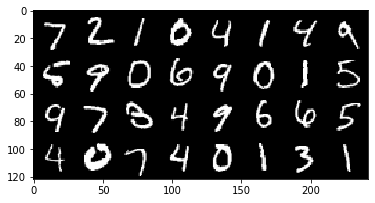

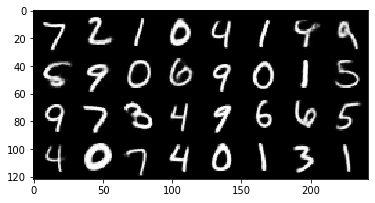

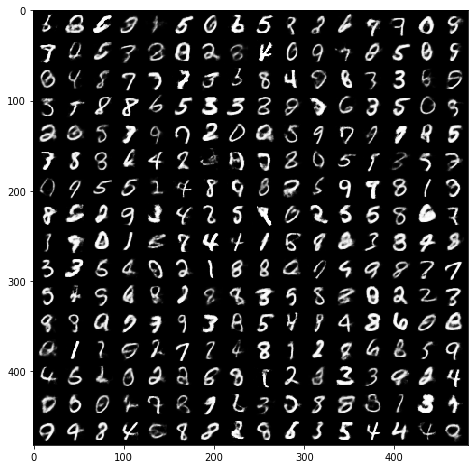

In [40]:
# *CODE FOR PART 1.2b IN THIS CELL*

# load the model
print('Input images')
print('-'*50)

sample_inputs, _ = next(iter(loader_test))
fixed_input = sample_inputs[0:32, :, :, :]
# visualize the original images of the last batch of the test set
img = make_grid(denorm(fixed_input), nrow=8, padding=2, normalize=False,
                range=None, scale_each=False, pad_value=0)
plt.figure()
show(img)

print('Reconstructed images')
print('-'*50)
with torch.no_grad():
    # visualize the reconstructed images of the last batch of test set
    
    #######################################################################
    #                       ** START OF YOUR CODE **
    #######################################################################
    recon_batch = model.forward(fixed_input.to(device))[0]
    #######################################################################
    #                       ** END OF YOUR CODE **
    ####################################################################### 
    
    recon_batch = recon_batch.cpu()
    recon_batch = make_grid(denorm(recon_batch), nrow=8, padding=2, normalize=False,
                            range=None, scale_each=False, pad_value=0)
    plt.figure()
    show(recon_batch)

print('Generated Images with beta = 0.5')

print('-'*50)
model.eval()
n_samples = 256
z = torch.randn(n_samples,latent_dim).to(device)
with torch.no_grad():
    #######################################################################
    #                       ** START OF YOUR CODE **
    #######################################################################
    samples = model.decode(z)
    #######################################################################
    #                       ** END OF YOUR CODE **
    ####################################################################### 
    
    samples = samples.cpu()
    samples = make_grid(denorm(samples), nrow=16, padding=2, normalize=False,
                            range=None, scale_each=False, pad_value=0)
    plt.figure(figsize = (8,8))
    show(samples)



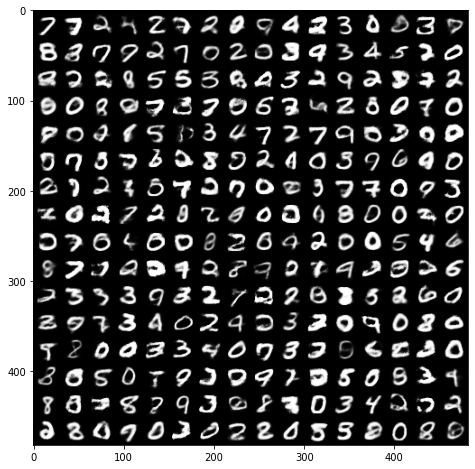

In [199]:
# THIS IS ANOTHER IMAGE I CREATED WITH BETA = 5

from IPython import display 
display.Image("./MNIST_Beta_5.png")


### Discussion
Provide a brief analysis of your loss curves and reconstructions: 
* What do you observe in the behaviour of the log-likelihood loss and the KL loss (increasing/decreasing)?
* Can you intuitively explain if this behaviour is desirable? Have you observed posterior collapse during traing (i.e. when the KL is too small during the early stages of training)? 
    * If yes, how did you mitigate it? How did this phenomenon reflect on your output samples?
    * If no, why do you think that is?

**YOUR ANSWER**

During training both the reconstruction log likelihood loss and the KL loss decrease dramatically over the first five to ten epochs. After this, both seem to stabilize and level off. Analysing the loss curves above we find that as we increase β the K-L loss decreases, which is to be expected as we are making the K-L divergence a more important term in our overall loss function. What is surprising however, is that the reconstruction log likelihood loss does not appear to increase as we increase β, which is surprising as for a  higher β we might assume that it would create a trade-off between reconstruction quality and the similarity of the distributions. The total loss is higher overall the larger β is, as the K-L loss value makes up a larger component and makes the total loss larger overall.    

The decrease of both of the losses is desirable behaviour as it implies that the model is learning to more accurately create new images that are similar to the real images. As the reconstruction log likelihood error decreases it shows us that the VAE network is getting better at reconstructing the images and as the K-L loss decreases it suggests that the distribution of the generated data gets closer to that of the input. Generated images with β = 5 appear much more defined than the the images generated with β = 0.5. This implies that the model is learning a more efficient representation of the data. 


A very common issue with VAE optimization is posterior collapse, in which the variational distribution collapses towards the prior, by learning to reconstruct the data independent of the latent variable z, and so the K-L loss vanishes to zero. This reduces the capacity of the generative model, making it impossible for the decoder network to make use of the information content of all of the latent dimensions. I only experienced posterior collapse during my training, when I set the β value to a very large value. For most values of β the K-L loss was initially high at the early stages of training and then decreased as several epochs passed. I believe there was no collapse here due to a well chosen learning rate and an appropriate β value.

---
<h2> Part 1.3 (11 points) <h2/>

Qualitative analysis of the learned representations

In this question you are asked to qualitatively assess the representations that your model has learned. In particular:

a. Dimensionality Reduction of learned embeddings

b. Interpolating in the latent space

## Part 1.3a: T-SNE on Embeddings (7 Points)
Extract the latent representations of the test set and visualize them using [T-SNE](https://en.wikipedia.org/wiki/T-distributed_stochastic_neighbor_embedding)  [(see implementation)](https://scikit-learn.org/stable/modules/generated/sklearn.manifold.TSNE.html). 

We've provided a function to visualize a subset of the data, but you are encouraged to also produce a matplotlib plot (please use different colours for each digit class).

In [8]:
# *CODE FOR PART 1.3a IN THIS CELL

# VISUALISATION FOR BETA = 0.5

from sklearn.manifold import TSNE
model.eval()

test_dataloader = DataLoader(test_dat, 10000, shuffle=False)
images, labels  = next(iter(test_dataloader))
images = images.to(device)

mu, logvar  = model.encode(images)
z_latent = model.reparametrize(mu, logvar)
z_latent = z_latent.cpu()

#Reduce to 2 dimension to visualise:

z_embedded = TSNE(n_components=2).fit_transform(z_latent.detach().numpy())

In [9]:
# Interactive Visualization - Code Provided
#test_dataloader = DataLoader(test_dat, 10000, shuffle=False)
""" Inputs to the function are
        z_embedded - X, Y positions for every point in test_dataloader
        test_dataloader - dataloader with batchsize set to 10000
        num_points - number of points plotted (will slow down with >1k)
"""
plot_tsne(z_embedded, test_dataloader, num_points=1000, darkmode=False)


alt.HConcatChart(...)

In [17]:
# VISUALISATION FOR BETA = 2

from sklearn.manifold import TSNE
model.eval()

test_dataloader = DataLoader(test_dat, 10000, shuffle=False)
images, labels  = next(iter(test_dataloader))
images = images.to(device)

mu, logvar  = model.encode(images)
z_latent = model.reparametrize(mu, logvar)
z_latent = z_latent.cpu()

#Reduce to 2 dimension to visualise:

z_embedded = TSNE(n_components=2).fit_transform(z_latent.detach().numpy())

In [18]:
# Interactive Visualization - Code Provided
#test_dataloader = DataLoader(test_dat, 10000, shuffle=False)
""" Inputs to the function are
        z_embedded - X, Y positions for every point in test_dataloader
        test_dataloader - dataloader with batchsize set to 10000
        num_points - number of points plotted (will slow down with >1k)
"""
plot_tsne(z_embedded, test_dataloader, num_points=1000, darkmode=False)

alt.HConcatChart(...)

### Discussion
What do you observe? Discuss the structure of the visualized representations. 
* What do you observe? What role do the KL loss term and $\beta$ have, if any, in what you observe (multiple matplotlib plots may be desirable here)?
    * Consider Outliers
    * Counsider Boundaries
    * Consider Clusters
* Is T-SNE reliable? What happens if you change the parameters (don't worry about being particularly thorough). [This link](https://distill.pub/2016/misread-tsne/) may be helpful.

**YOUR ANSWER**

T-Distributed Stochastic Neighbor Embedding (T-SNE) is an unsupervised, non-linear technique primarily used for data exploration and visualizing high-dimensional data. In simpler terms, T-SNE gives you a feel or intuition of how the data is arranged in a high-dimensional space. 

From the experiments that I ran I found that the larger the β value, the more the clusters appeared to be less separated and overlap more. For lower values of β, the clusters are more clearly defined.

Clusters such as 3 and 5 and 8 are all close to each other and this makes sense, as they have similar structural features such as the curve on the bottom half of the number. The VAE will pick out these similar features and when projected to the latent space, similar shaped numbers will be close to each other. 4 and 9 are another example with similar shapes and structure and therefore appear close together in the diagram and have a boundary between the two clusters.

Each cluster is mainly made up of a single number. There are of course outliers. A very distinguishable outlier in the β = 2 T-SNE plot is the 9 in the 0 cluster. Analysing this further we see that the 9 does almost look indentical to a 0, as it is extremely deformed. This is further evidence that numbers that look similar are clustered nearer to each other.


Sometimes in T-SNE different runs with the same hyperparameters may produce different results hence multiple plots must be observed before making any assessment with T-SNE. Perplexity is a very important tuneable parameter, which gives an idea of how to balance attention between local and global aspects of your data. A perplexity of 2 means that local variations dominate. Another important point to recall is that cluster size means nothing in these plots, and distances between clusters might not mean anything either. However, given all of these shortcomings, T-SNE does give us a way to visualize high-dimensional data, we must just be very careful not to misread these images.  


## Part 1.3b: Interpolating in $z$ (4 Points)
Perform a linear interpolation in the latent space of the autoencoder by choosing any two digits from the test set. What do you observe regarding the transition from on digit to the other?


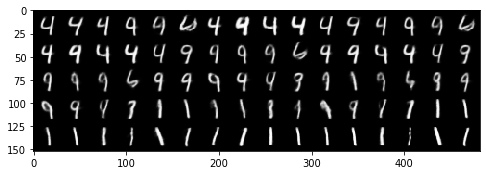

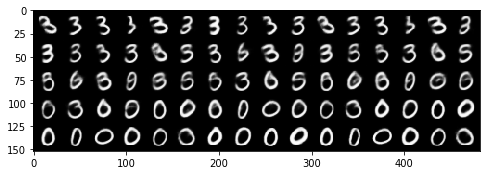

In [14]:
# CODE FOR PART 1.3b IN THIS CELL
model.eval()

with torch.no_grad():
    l_1, l_2 = 1, 4
    d_1, d_2 = images[labels == l_1][:10], images[labels == l_2][:10]

    d_1_mu, d_1_logvar = model.encode(d_1)
    d_2_mu, d_2_logvar = model.encode(d_2)

    z1 = model.reparametrize(d_1_mu, d_1_logvar)
    z2 = model.reparametrize(d_2_mu, d_2_logvar)
    
    vecs = []
    n = 8
    ratios = np.linspace(0, 1, n)
    
    for i in ratios:
        v = i * z1 + (1 - i) *z2
        decode_z = model.decode(v)    
        decode_z = decode_z.cpu()
        vecs.append(decode_z)  
    
    
    vecs = make_grid(torch.cat(vecs, 0), nrow=16, padding=2, normalize=False,
                            range=None, scale_each=False, pad_value=0)
    plt.figure(figsize = (8,8))
    show(vecs)

    
with torch.no_grad():
    l_1, l_2 = 0, 3
    d_1, d_2 = images[labels == l_1][:10], images[labels == l_2][:10]

    d_1_mu, d_1_logvar = model.encode(d_1)
    d_2_mu, d_2_logvar = model.encode(d_2)

    z1 = model.reparametrize(d_1_mu, d_1_logvar)
    z2 = model.reparametrize(d_2_mu, d_2_logvar)
    
    vecs = []
    n = 8
    ratios = np.linspace(0, 1, n)
    
    for i in ratios:
        v = i * z1 + (1 - i) *z2
        decode_z = model.decode(v)    
        decode_z = decode_z.cpu()
        vecs.append(decode_z)  
    
    
    vecs = make_grid(torch.cat(vecs, 0), nrow=16, padding=2, normalize=False,
                            range=None, scale_each=False, pad_value=0)
    plt.figure(figsize = (8,8))
    show(vecs)

### Discussion
What did you observe in the interpolation? Is this what you expected?
* Can you relate the interpolation to your T-SNE visualization

**YOUR ANSWER** (all these interpolation plots are based on β = 2 run of the VAE algorithm)

We can see through both the interpolations plotted above that the algorithm is clearly able to go from producing one digit to producing another digit by varying the ratio of the latent vectors input into the VAE decoder, and we see a smooth transition from one number to the next. There is a very beautiful relation to the T-SNE plot above for β = 2. We can clearly see that for the interpolation between 4 and 1 in our interpolation grid, it appears to produce the number 9 when we are in the middle of the interpolation. Looking at the T-SNE graph we can see that the 9 cluster is exactly in the middle of the the 1 and the 4 clusters. We repeated the experiment with the numbers 0 and 3. Here we can see that the number 5 cluster is in the middle between 0 and 3 clusters in the T-SNE graph, and again in our interpolation grid we can see that we are producing a number that looks similar to 5 as we interpolate between 0 and 3. 



# Part 2 - Deep Convolutional GAN

In this task, your main objective is to train a DCGAN (https://arxiv.org/abs/1511.06434) on the CIFAR-10 dataset. You should experiment with different architectures, tricks for stability in training (such as using different activation functions, batch normalization, different values for the hyper-parameters, etc.). In the end, you should provide us with: 

- your best trained model (which we will be able to run), 
- some generations for the fixed latent vectors $\mathbf{z}\sim \mathcal{N}\left(\mathbf{0}, \mathbf{I}\right)$ we have provided you with (train for a number of epochs and make sure there is no mode collapse), 
- plots with the losses for the discriminator $D$ and the generator $G$ as the training progresses and explain whether your produced plots are theoretically sensible and why this is (or not) the case. 
- a discussion on whether you noticed any mode collapse, where this behaviour may be attributed to, and explanations of what you did in order to cope with mode collapse. 

## Part 2.1 (30 points)
**Your Task**: 

a. Implement the DCGAN architecture. 

b. Define a loss and implement the Training Loop

c. Visualize images sampled from your best model's generator ("Extension" Assessed on quality)

d. Discuss the experimentations which led to your final architecture. You can plot losses or generated results by other architectures that you tested to back your arguments (but this is not necessary to get full marks).


_Clarification: You should not be worrying too much about getting an "optimal" performance on your trained GAN. We want you to demonstrate to us that you experimented with different types of DCGAN variations, report what difficulties transpired throughout the training process, etc. In other words, if we see that you provided us with a running implementation, that you detail different experimentations that you did before providing us with your best one, and that you have grapsed the concepts, you can still get good marks. The attached model does not have to be perfect, and the extension marks for performance are only worth 10 points._

In [2]:
import os
import numpy as np
import torch
import torch.nn as nn
from torch.utils.data import DataLoader
from torch.utils.data import sampler
from torchvision import datasets, transforms
from torchvision.utils import save_image, make_grid
from torch.optim.lr_scheduler import StepLR, MultiStepLR
import torch.nn.functional as F
import matplotlib.pyplot as plt


def denorm(x, channels=None, w=None ,h=None, resize = False):
    x = 0.5 * (x + 1)
    x = x.clamp(0, 1)
    if resize:
        if channels is None or w is None or h is None:
            print('Number of channels, width and height must be provided for resize.')
        x = x.view(x.size(0), channels, w, h)
    return x

def show(img):
    npimg = img.cpu().numpy()
    plt.imshow(np.transpose(npimg, (1,2,0)))

if not os.path.exists('/storage/icl_dl_cw2/CW_GAN'):
    os.makedirs('/storage/icl_dl_cw2/CW_GAN')

GPU = True # Choose whether to use GPU
if GPU:
    device = torch.device("cuda"  if torch.cuda.is_available() else "cpu")
else:
    device = torch.device("cpu")
print(f'Using {device}')

# We set a random seed to ensure that your results are reproducible.
if torch.cuda.is_available():
    torch.backends.cudnn.deterministic = True
torch.manual_seed(0)

Using cuda


### Part 2.1a: Implement DCGAN (8 Points)
Fill in the missing parts in the cells below in order to complete the Generator and Discriminator classes. You will need to define:

- The hyperparameters
- The constructors
- `decode`
- `discriminator`

Recomendations for experimentation:
- use the architecture that you implemented for the Autoencoder of Part 1 (encoder as discriminator, decoder as generator).
- use the architecture desribed in the DCGAN paper (https://arxiv.org/abs/1511.06434).

Some general reccomendations:
- add several convolutional layers (3-4).
- accelerate training with batch normalization after every convolutional layer.
- use the appropriate activation functions. 
- Generator module: the upsampling can be done with various methods, such as nearest neighbor upsampling (`torch.nn.Upsample`) or transposed convolutions(`torch.nn.ConvTranspose2d`). 
- Discriminator module: Experiment with batch normalization (`torch.nn.BatchNorm2d`) and leaky relu (`torch.nn.LeakyReLu`) units after each convolutional layer.

Try to follow the common practices for CNNs (e.g small receptive fields, max pooling, RELU activations), in order to narrow down your possible choices.

<font color="red">**Your model should not have more than 25 Million Parameters**</font>

The number of epochs that will be needed in order to train the network will vary depending on your choices. As an advice, we recommend that while experimenting you should allow around 20 epochs and if the loss doesn't sufficiently drop, restart the training with a more powerful architecture. You don't need to train the network to an extreme if you don't have the time.

#### Data loading

In [3]:
batch_size = 32

transform = transforms.Compose([
     transforms.ToTensor(),
     transforms.Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5),),                        
])

data_dir = './datasets'

cifar10_train = datasets.CIFAR10(data_dir, train=True, download=True, transform=transform)
cifar10_test = datasets.CIFAR10(data_dir, train=False, download=True, transform=transform)
loader_train = DataLoader(cifar10_train, batch_size=batch_size)
loader_test = DataLoader(cifar10_test, batch_size=batch_size)

Files already downloaded and verified
Files already downloaded and verified


We'll visualize a subset of the test set: 

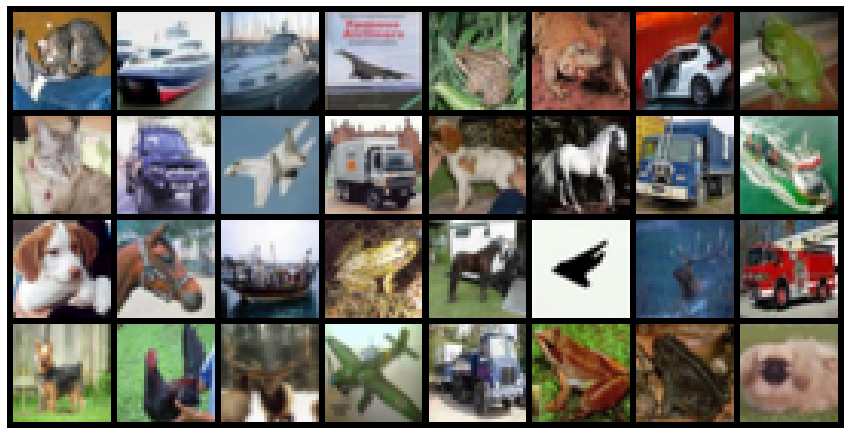

In [4]:
samples, _ = next(iter(loader_test))


samples = samples.cpu()
samples = make_grid(denorm(samples), nrow=8, padding=2, normalize=False,
                        range=None, scale_each=False, pad_value=0)
plt.figure(figsize = (15,15))
plt.axis('off')
show(samples)

#### Model Definition
Define hyperparameters and the model

In [5]:
# *CODE FOR PART 2.1 IN THIS CELL*

num_epochs = 50
learning_rate = 0.0002
latent_vector_size = 100

# Other hyperparams

size_of_fm_in_generator = 64
size_of_fm_in_discriminator = 64

In [6]:
# *CODE FOR PART 2.1 IN THIS CELL*


class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        
        self.size_of_fm_in_generator = 64
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################
        self.decode = nn.Sequential(nn.ConvTranspose2d(latent_vector_size, self.size_of_fm_in_generator*16, 4, 1, 0, bias=False),
            nn.BatchNorm2d(self.size_of_fm_in_generator*16),
            nn.ReLU(True),
            nn.Dropout(0.3),
                                    
            nn.ConvTranspose2d(self.size_of_fm_in_generator*16, self.size_of_fm_in_generator*8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(self.size_of_fm_in_generator*8),
            nn.ReLU(True),
            nn.Dropout(0.3),
                                    
            nn.ConvTranspose2d(self.size_of_fm_in_generator*8, self.size_of_fm_in_generator*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(self.size_of_fm_in_generator*4),
            nn.ReLU(True),
            nn.Dropout(0.3),
                                    
            nn.ConvTranspose2d(self.size_of_fm_in_generator*4, 3, 4, 2, 1, bias=False),
            nn.Tanh()  
        )
        #######################################################################
        #                       ** END OF YOUR CODE **
        ####################################################################### 


    def forward(self, z): # i have manually taken out label here as an input
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################
        out = self.decode(z)
        #######################################################################
        #                       ** END OF YOUR CODE **
        #######################################################################
        return out


class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################
        self.discr = nn.Sequential(
        
            nn.Conv2d(3, size_of_fm_in_discriminator*2, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(size_of_fm_in_discriminator*2, size_of_fm_in_discriminator*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(size_of_fm_in_discriminator * 4),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(size_of_fm_in_discriminator*4, size_of_fm_in_discriminator*8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(size_of_fm_in_discriminator * 8),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(size_of_fm_in_discriminator*8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()   
        )
        #######################################################################
        #                       ** END OF YOUR CODE **
        ####################################################################### 
        
    def forward(self, x): # i have manually taken out label here 
        #######################################################################
        #                       ** START OF YOUR CODE **
        #######################################################################
        out = self.discr(x).view(-1,1).squeeze(1)
        #######################################################################
        #                       ** END OF YOUR CODE **
        ####################################################################### 
        
        return out

<h2> Initialize Model and print number of parameters </h2>

You can use method `weights_init` to initialize the weights of the Generator and Discriminator networks. Otherwise, implement your own initialization, or do not use at all. You will not be penalized for not using initialization.

In [7]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)

In [8]:
use_weights_init = True

model_G = Generator().to(device)
if use_weights_init:
    model_G.apply(weights_init)
params_G = sum(p.numel() for p in model_G.parameters() if p.requires_grad)
print("Total number of parameters in Generator is: {}".format(params_G))
print(model_G)
print('\n')

model_D = Discriminator().to(device)
if use_weights_init:
    model_D.apply(weights_init)
params_D = sum(p.numel() for p in model_D.parameters() if p.requires_grad)
print("Total number of parameters in Discriminator is: {}".format(params_D))
print(model_D)
print('\n')

print("Total number of parameters is: {}".format(params_G + params_D))

Total number of parameters in Generator is: 12140032
Generator(
  (decode): Sequential(
    (0): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Dropout(p=0.3, inplace=False)
    (4): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (5): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): ReLU(inplace=True)
    (7): Dropout(p=0.3, inplace=False)
    (8): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): ReLU(inplace=True)
    (11): Dropout(p=0.3, inplace=False)
    (12): ConvTranspose2d(256, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


Total number of parameters in Discri

### Part 2.1b: Training the Model (12 Points)

#### Defining a Loss

In [9]:
criterion = nn.BCELoss()
#criterion = nn.MSELoss()

def loss_function(out, label):
    loss = criterion(out, label)
    return loss

<h3>Choose and initialize optimizers</h3>

In [10]:
# setup optimizer
# You are free to add a scheduler or change the optimizer if you want. We chose one for you for simplicity.
beta1 = 0.5
optimizerD = torch.optim.Adam(model_D.parameters(), lr=learning_rate, betas=(beta1, 0.999))
optimizerG = torch.optim.Adam(model_G.parameters(), lr=learning_rate, betas=(beta1, 0.999))


<h3> Define fixed input vectors to monitor training and mode collapse. </h3>

In [11]:
fixed_noise = torch.randn(batch_size, latent_vector_size, 1, 1, device=device)
real_label = 1
fake_label = 0

def scale(x, feature_range=(-1, 1)):
    ''' Scale takes in an image x and returns that image, scaled
       with a feature_range of pixel values from -1 to 1. 
       This function assumes that the input x is already scaled from 0-1.'''
    
    # scale from 0-1 to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

#### Training Loop

In [ ]:
train_losses_G = []
train_losses_D = []

for epoch in range(num_epochs):
    for i, data in enumerate(loader_train, 0):
        train_loss_D = 0
        train_loss_G = 0
        
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################device
        # Train with real
        
        model_D.zero_grad()
        real_cpu = data[0].to(device)
        
        batch_size = real_cpu.size(0)
        label = torch.full((batch_size,), (real_label) , dtype=torch.float, device=device)
        
        # add label smoothing 
        label = label - 0.05 + (torch.rand(label.shape, dtype=torch.float, device=device) * 0.1)
       
        
        #Perform discriminator forward pass with real images:
        D_out = model_D(real_cpu)
        
        # Calculate loss on the real images
        D_error_real = loss_function(D_out, label)
        
        # my attempt to implement Least Squares GAN with L2 loss
        #D_error_real = torch.mean((D_out - label)**2) 

        #Perform backward pass on the Discriminator using the loss on real images
        D_error_real.backward()
        
        D_x = D_out.mean().item()


        # Train with fake

        # Generate latent vectors
        noise = torch.randn(batch_size, latent_vector_size, 1, 1, device=device)
        # Use the generator and the latent vector to generate batch of fake images
        fake = model_G(noise)
        label.fill_(fake_label)
        label = label + torch.rand(label.shape, dtype=torch.float, device=device) * 0.05
        #print(label)
        
        #Use discriminator to classify the generated (fake) images:
        D_out = model_D(fake.detach())#.view(-1)
        
        # Calculate loss and corresponding gradients of discriminator
        D_error_fake = loss_function(D_out, label)
        #D_error_fake = torch.mean((D_out - label)**2)
        
        D_error_fake.backward()
        
        D_G_z1 = D_out.mean().item()
        
        #Add both losses (fake and real)
        
        D_error_total = 0.5 * (D_error_real + D_error_fake)
        train_loss_D += D_error_total
        
        # Update Discriminator
        optimizerD.step()


        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        model_G.zero_grad()
        
        # no label smoothing here 
        label = torch.full((batch_size,), (real_label) , dtype=torch.float, device=device)
        
        
        #Perform another forward pass on the discriminator using fake images
        G_out = model_D(fake)
        # Use the output to calculate generator loss:
        
        G_error = loss_function(G_out, label)
        
        #G_error = 0.5 * torch.mean((G_out - label)**2)
        
        
        #Backward pass, gradient calculation and generator update:
        G_error.backward()
        D_G_z2 = G_out.mean().item()
        train_loss_G += G_error.item()
        optimizerG.step()
        

    print('[%d/%d][%d/%d] Loss_D: %.4f Loss_G: %.4f D(x): %.4f D(G(z)): %.4f / %.4f'
          % (epoch, num_epochs, i, len(loader_train),
             D_error_total.item(), G_error.item(), D_x, D_G_z1, D_G_z2))

    if epoch == 0:
        save_image(denorm(real_cpu.cpu()).float(), '/storage/icl_dl_cw2/CW_GAN/real_samples.png')
    with torch.no_grad():
        fake = model_G(fixed_noise)
        save_image(denorm(fake.cpu()).float(), '/storage/icl_dl_cw2/CW_GAN/fake_samples_epoch_%03d.png' % epoch)
    train_losses_D.append(train_loss_D / len(loader_train))
    train_losses_G.append(train_loss_G / len(loader_train))
   
    
 # save  models 
 # if your discriminator/generator are conditional you'll want to change the inputs here
torch.jit.save(torch.jit.trace(model_G, (fixed_noise)), '/storage/icl_dl_cw2/CW_GAN/GAN_G_model.pth')
torch.jit.save(torch.jit.trace(model_D, (fake)), '/storage/icl_dl_cw2/CW_GAN/GAN_D_model.pth')

print(train_losses_D)
print(train_losses_G)



[0/50][0/1563] Loss_D: 1.0387 Loss_G: 1.9849 D(x): 0.3254 D(G(z)): 0.4167 / 0.1426
[0/50][1/1563] Loss_D: 1.1447 Loss_G: 3.1002 D(x): 0.7225 D(G(z)): 0.7695 / 0.0682
[0/50][2/1563] Loss_D: 0.9147 Loss_G: 4.0733 D(x): 0.6925 D(G(z)): 0.6458 / 0.0216
[0/50][3/1563] Loss_D: 0.6809 Loss_G: 4.0148 D(x): 0.6180 D(G(z)): 0.4189 / 0.0211
[0/50][4/1563] Loss_D: 0.6793 Loss_G: 3.7452 D(x): 0.5779 D(G(z)): 0.3340 / 0.0267
[0/50][5/1563] Loss_D: 0.4672 Loss_G: 4.3274 D(x): 0.7325 D(G(z)): 0.3443 / 0.0156
[0/50][6/1563] Loss_D: 0.6288 Loss_G: 5.4493 D(x): 0.7145 D(G(z)): 0.4864 / 0.0052
[0/50][7/1563] Loss_D: 0.5301 Loss_G: 5.1565 D(x): 0.6174 D(G(z)): 0.2530 / 0.0071
[0/50][8/1563] Loss_D: 0.4265 Loss_G: 5.3130 D(x): 0.7229 D(G(z)): 0.2877 / 0.0056
[0/50][9/1563] Loss_D: 0.3458 Loss_G: 5.4188 D(x): 0.7572 D(G(z)): 0.2186 / 0.0054
[0/50][10/1563] Loss_D: 0.3023 Loss_G: 5.8874 D(x): 0.8159 D(G(z)): 0.2503 / 0.0031
[0/50][11/1563] Loss_D: 0.3448 Loss_G: 7.0468 D(x): 0.8120 D(G(z)): 0.3108 / 0.0010
[0

## Part 2.1c: Results (10 Points)
This part is fairly open-ended, but not worth too much so do not go crazy. The table below shows examples of what are considered good samples. Level 3 and above will get you 10/10 points, level 2 will roughly get you 5/10 points and level 1 and below will get you 0/10 points.

<table><tr>
<td> 
  <p align="center" style="padding: 10px">
    <img alt="Forwarding" src="https://drive.google.com/uc?id=1wQ2f10-A1Vs7k0LMfBPPyYTsPlkBF9QE" width="%30">
    <br>
    <em style="color: grey">Level 1</em>
  </p> 
</td>
<td> 
  <p align="center">
    <img alt="Routing" src="https://drive.google.com/uc?id=1wlDhX4hROET4s8Ndxn8nhj_0RLM2rnuG" width="%30">
    <br>
    <em style="color: grey">Level 2</em>
  </p> 
</td>
<td> 
  <p align="center">
    <img alt="Routing" src="https://drive.google.com/uc?id=1w9VrgfJLCRaTPhwoFVYdYhtCeaQmFHGb" width="%30">
    <br>
    <em style="color: grey">Level 3</em>
  </p> 
</td>
</tr></table>

### Generator samples


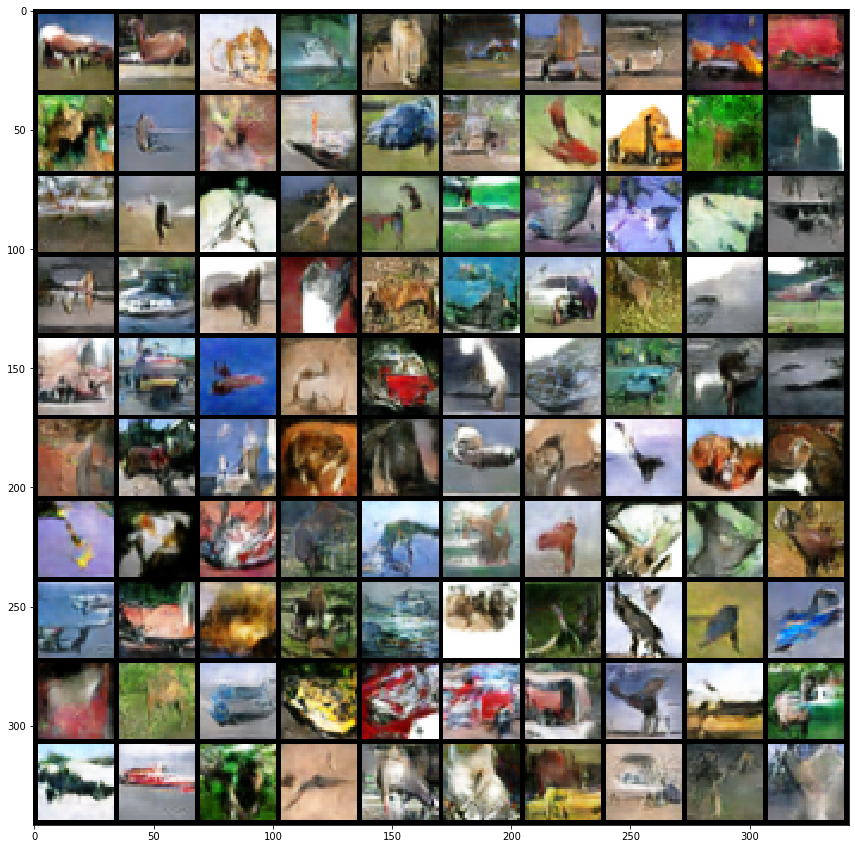

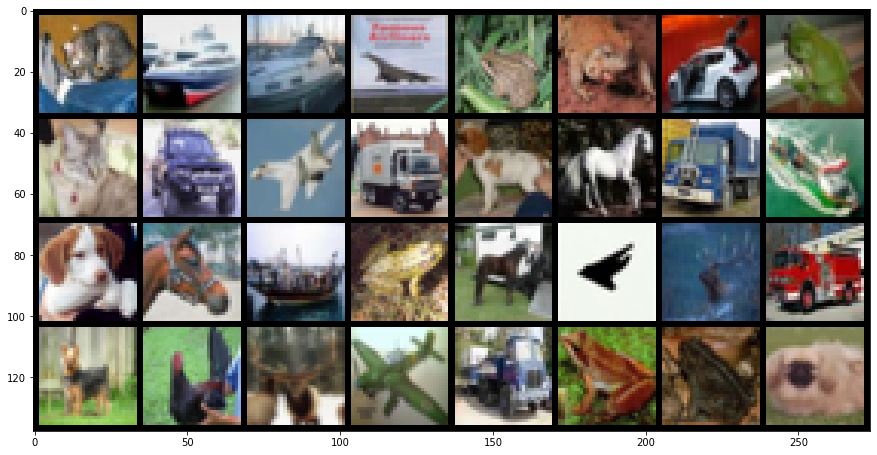

In [21]:
input_noise = torch.randn(100, latent_vector_size, 1, 1, device=device)
with torch.no_grad():
    # visualize the generated images
    generated = model_G(input_noise).cpu()
    generated = make_grid(denorm(generated)[:100], nrow=10, padding=2, normalize=False, 
                        range=None, scale_each=False, pad_value=0)
    plt.figure(figsize=(15,15))
    show(generated)
    save_image(generated,'/storage/icl_dl_cw2/CW_GAN/Teaching30final.png')
    #show(generated) # note these are now class conditional images columns rep classes 1-10

it = iter(loader_test)
sample_inputs, _ = next(it)
fixed_input = sample_inputs[0:64, :, :, :]
# visualize the original images of the last batch of the test set for comparison
img = make_grid(denorm(fixed_input), nrow=8, padding=2, normalize=False,
                range=None, scale_each=False, pad_value=0)
plt.figure(figsize=(15,15))
show(img)

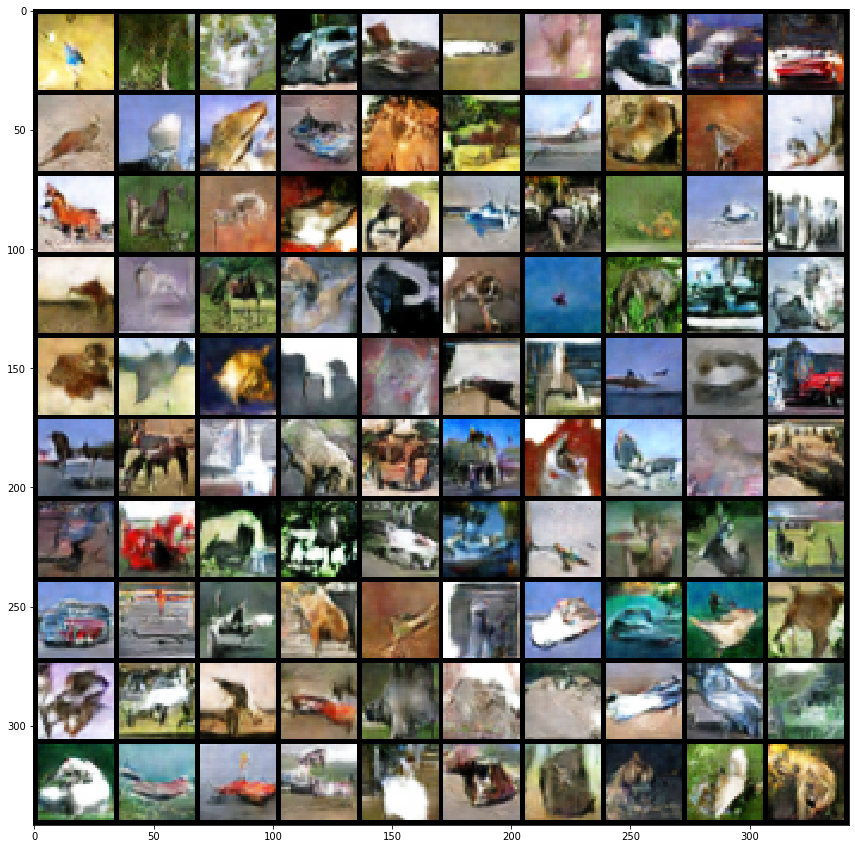

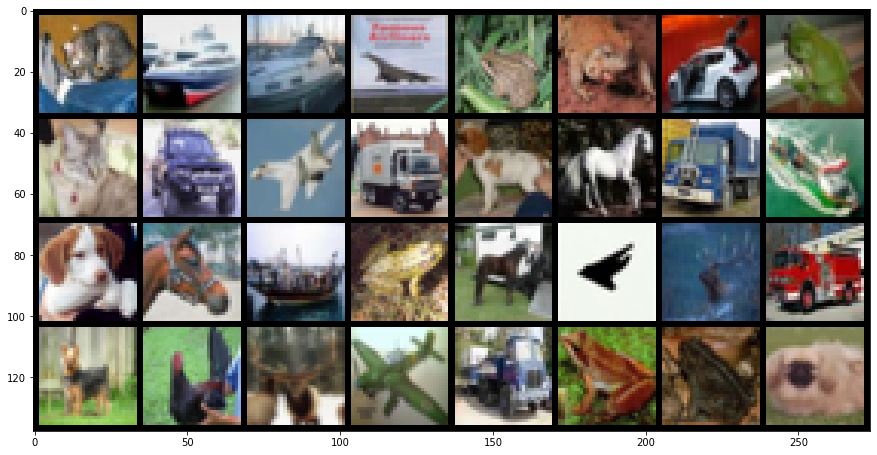

In [14]:
input_noise = torch.randn(100, latent_vector_size, 1, 1, device=device)
with torch.no_grad():
    # visualize the generated images
    generated = model_G(input_noise).cpu()
    generated = make_grid(denorm(generated)[:100], nrow=10, padding=2, normalize=False, 
                        range=None, scale_each=False, pad_value=0)
    plt.figure(figsize=(15,15))
    show(generated)
    save_image(generated,'/storage/icl_dl_cw2/CW_GAN/Teaching30final.png')
    #show(generated) # note these are now class conditional images columns rep classes 1-10

it = iter(loader_test)
sample_inputs, _ = next(it)
fixed_input = sample_inputs[0:64, :, :, :]
# visualize the original images of the last batch of the test set for comparison
img = make_grid(denorm(fixed_input), nrow=8, padding=2, normalize=False,
                range=None, scale_each=False, pad_value=0)
plt.figure(figsize=(15,15))
show(img)

## Part 2.1d: Engineering Choices (10 Points)

Discuss the process you took to arrive at your final architecture. This should include:

* Which empirically useful methods did you utilize
* What didn't work, what worked and what mattered most
* Are there any tricks you came across in the literature etc. which you suspect would be helpful here

**Your Answer**

### Implementation and Tricks 

I originally implemented a DCGAN as explained in 'Unsupervised Representation Learning with Deep Convolutional Generative Adversarial Networks' by Radford et al.. I had to make some minor changes to the architecture so that my 32x32 sized images fit as inputs rather than the 64x64 images the network was built to receive. 


Some of the tricks I used were the BatchNorm2d layers followed by ReLU layers, as this would make the inputs of the non-linearity more stable (Batch-Norm paper). Further, to avoid sparse gradients from flowing inside my network, I have replaced the ReLU with Leaky ReLUs in my discriminator as this gives small negative values to inactive units, leading to a slightly better performance. For my GAN, I followed the recommendation to not use pooling layers, and instead use the stride in convolutional layers to perform downsampling in the discriminator model.


I attempted to implement Least Squares GAN with L2 loss. I implemented this approach on the observation of the limitations for using binary cross entropy loss when generated images are very different from real images, which can lead to very small or vanishing gradients, and in turn, little or no update to the model. However, when I implemented this it ended up leading to mode collapse.


I used label smoothing by adding soft labels with small random noise for the Discriminator, to prevent the discriminator from getting too strong. The implementation included using values slightly more or less than 1.0, ([0.7, 1.2]) or slightly more than 0.0 ([0.0, 0.3]) for real and fake images respectively, where the variation for each image is random. This label smoothing can have a regularizing effect when training the model. I also provided additional noise in the form of dropout (30%). I applied it on several layers of my generator at both training and test time. Both of these two appeared to visually improve the quality of my images.

I attempted to scale the images in the feature_range of pixel values from -1 to 1. However this just made the images darker but did not appear to improve the quality of the actual image, so I did not use it in the final implementation.  


I expected larger batch size to improve image quality, but in fact it led to far more artefacts and blurrier images. I then read into this topic online and found several articles that explained that while training a GAN it is ideal to use a batch size smaller than or equal to 64. Using a bigger batch size might hurt the performance because during the initial training the discriminator might get a lot of examples to train on and it might overpower the generator, which would have a negative effect on training.




I looked to increase the number of parameters in the generator (more feature maps), relative to the discriminator. I attempted this as my discriminator continuously overpowered the generator and did not allow it to learn effectively. Essentially the discriminator got too strong relative to the generator. Beyond this point, the generator found it almost impossible to fool the discriminator. I realise that this is against the advice of several journals that recommend to make the discriminator more complex than the generator, however when I analysed the images, increasing the capacity of the generator did improve the overall result of the generated images. I believe that this worked because it increased the capacity of the model relative to the complexity of the dataset. I achieved this increase in generator complexity by doubling the number of channels or feature maps (filters) in each layer.



### Going Further

Looking further, I could have tried adding further artificial noise to inputs of D. This could be implemented by introducing some errors to these labels where some fake images are marked as real, and some real images are marked as fake. As I was using separate batches to update the discriminator for real and fake images, this may mean randomly adding some fake images to the batch of real images, or randomly adding some real images to the batch of fake images.




Doing some extra reading into the topic of GANs, if we want to really go the extra mile we could attempt to design and implement the fascinating architecture of a CycleGAN as below: 
When a CycleGAN trains, and sees one batch of real images from set $X$ and $Y$, it trains by performing the following steps:

Training the Discriminators:

Compute the discriminator $D_X$ loss on real images.

Generate fake images that look like domain $X$ based on real images in domain $Y$.

Compute the fake loss for $D_X$.

Compute the total loss and perform backpropagation and $D_X$ optimization.

Repeat steps 1-4 only with $D_Y$ and your domains switched!

Training the Generators:

Generate fake images that look like domain $X$ based on real images in domain $Y$.

Compute the generator loss based on how $D_X$ responds to fake $X$.

Generate reconstructed $\hat{Y}$ images based on the fake $X$ images generated in step 1.

Compute the cycle consistency loss by comparing the reconstructions with real $Y$ images.

Repeat steps 1-4 only swapping domains.

Add up all the generator and reconstruction losses and perform backpropagation + optimization.

(cited from: https://towardsdatascience.com/image-to-image-translation-using-cyclegan-model-d58cfff04755)

## Part 2.2: Understanding GAN Training (5 points)


### Loss Curves
**Your task:**


Plot the losses curves for the discriminator $D$ and the generator $G$ as the training progresses and explain whether the produced curves are theoretically sensible and why this is (or not) the case (x-axis: epochs, y-axis: loss).

Make sure that the version of the notebook you deliver includes these results.

50


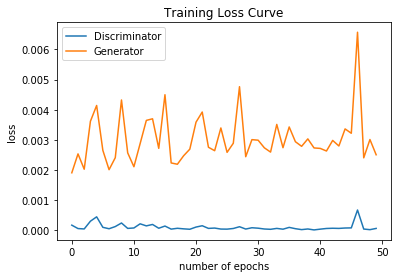

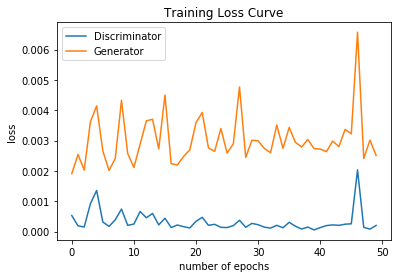

In [30]:
# ANSWER FOR PART 2.2 IN THIS CELL*

# TRAINING LOSS PLOT 

l = [x * 3 for x in train_losses_D]


plt.plot(list(range(0, num_epochs)), np.array(train_losses_D), label='Discriminator')
plt.plot(list(range(0, num_epochs)), np.array(train_losses_G), label='Generator')

plt.title('Training Loss Curve')
plt.xlabel("number of epochs")
plt.ylabel("loss")

plt.legend()
plt.show()



plt.plot(list(range(0, num_epochs)), np.array(l), label='Discriminator')
plt.plot(list(range(0, num_epochs)), np.array(train_losses_G), label='Generator')

plt.title('Training Loss Curve')
plt.xlabel("number of epochs")
plt.ylabel("loss")

plt.legend()
plt.show()


### Discussion

Do your loss curves look sensible? What would you expect to see and why?

**YOUR ANSWER** (the loss curves plotted, the top is the normal curve and the bottom is the same curve but with the discriminator loss tripled in value to emphasize its peaks and troughs)


For GANs the losses are very non-intuitive. In most cases it happens that as the generator and discriminator are competing against each other, improvement in one means the higher loss on the other, until this other learns better on the received loss, which screws up its competitor, and so on.


The losses plotted from my GAN model are somewhat erratic early in the run and do not seem to stabilize. My interpretation is that the model was not run for enough epochs to reach convergence.  


Loss convergence would normally signify that the GAN model found some optimum, where it can't improve more, which also should mean that it has learned well enough. However, this is not a requirement for the GAN to learn well. Many papers state that there are no good objective metrics for evaluating whether a GAN is performing well during training, i.e. reviewing loss is not sufficient. Instead, the best approach is to visually inspect generated examples and use subjective evaluation. We can clearly see for the images produced above that they are of high quality and analysing them as we move through the epochs is a better measure for how well the model is learning. Even if the model converged well, we must still check the generated examples - sometimes the generator finds one/few examples that the discriminator cannot distinguish from the genuine data.


One thing that has baffled me about my loss curve is the fact that the generator loss seems to have spike increases when the discriminator loss has spike increases. This seems extremely counterintuitive as the two are playing a competitive min/max game against each other and therefore I would expect one to decrease when the other increases. I have scoured the literature and I was unable to find any reasoning why this may occur. I can potentially hypothesize that this is random and that we do not have enough epochs to know for certain. However, it does appear from this loss curve that the generator and discriminator are learning together at the same time, which is very confusing. Overall though, looking at the generated images, the GAN has produced high quality images, irrespective of the confusing looking loss curves. 

## Part 2.3: Understanding Mode Collapse (5 points) 
**Your task:** 

Based on the images created by your generator using the `fixed_noise` vector during training, provide a discussion on whether you noticed any mode collapse, what this behaviour may be attributed to, and explain what you did in order to cope with mode collapse.

### Discussion


**YOUR ANSWER**

A mode collapse, also known as the scenario, refers to a generator model that is only capable of generating one or a small subset of different outcomes, or modes. 

This occurs when the generator learns to map several different input z values from the latent space to the same output point, therefore we output the same image regardless of the input latent variable z. This results in one or a small subset of generated images. However, it means that a mode collapse can be identified when reviewing a large sample of generated images. The images will show low diversity, with the same identical image or same small subset of identical images repeating many times. A mode collapse can also be identified by reviewing the line plot of model loss. The line plot will show oscillations in the loss over time, most notably in the generator model, as the generator model is updated and jumps from generating one mode to another model that has different loss. A simple intuitive explanation for mode collapse is that the generator finds a class (mode) that can trick the discriminator, and keeps producing that specific class and/or image.

Based on the images generated using the fixed_noise vector, I did not notice any mode collapse. It is a fairly easy model failure to spot as reviewing generated images shows the expected feature of mode collapse, namely many identical generated examples, regardless of the input point in the latent space. 

If I had however had mode collapse, we can prevent our GAN from suffering from mode collapse in a number of ways. Perhaps the most reliable is to restrict the size of the latent dimension directly, forcing the model to only generate a small subset of plausible outputs. In addition, usually introducing some diversity to your data helps. Another ingenious idea is to use an experience replay buffer, which allows the discriminator to learn the generator's tricks (by showing generated samples to the discriminator).



# TA Test Cell
TAs will run this cell to ensure that your results are reproducible, and that your models have been defined suitably. 

<font color="blue"> <b> Please provide the input and output transformations required to make your VAE and GANs work. If your GAN generator requires more than just noise as input, also specify this below (there are two marked cells for you to inspect) </b></font>


In [15]:
# If you want to run these tests yourself, change directory:
!cd /storage/icl_dl_cw2/
!pwd

/notebooks


In [16]:
!pip install -q torch torchvision

You should consider upgrading via the 'pip install --upgrade pip' command.


In [17]:
# Do not remove anything here
import os
import numpy as np
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, sampler
from torchvision import datasets, transforms
from torchvision.utils import save_image, make_grid
import torch.nn.functional as F
import matplotlib.pyplot as plt 

show = lambda img: plt.imshow(np.transpose(img.cpu().numpy(), (1,2,0)))

device = torch.device("cuda"  if torch.cuda.is_available() else "cpu")

# Do not change this cell!
torch.backends.cudnn.deterministic = True
torch.manual_seed(0)

In [18]:
############# CHANGE THESE (COPY AND PASTE FROM YOUR OWN CODE) #############
vae_transform = transforms.Compose([
    transforms.ToTensor(),
])

def vae_denorm(x):
    return x


def gan_denorm(x, channels=None, w=None ,h=None, resize = False):
    x = 0.5 * (x + 1)
    x = x.clamp(0, 1)
    if resize:
        if channels is None or w is None or h is None:
            print('Number of channels, width and height must be provided for resize.')
        x = x.view(x.size(0), channels, w, h)
    return x


gan_latent_size = 100

# If your generator requires something other than noise as input, please specify
# two cells down from here

In [19]:
# Load VAE Dataset
test_dat = datasets.MNIST("./data/", train=False, transform=vae_transform, 
                          download=True)
vae_loader_test = DataLoader(test_dat, batch_size=32, shuffle=False)

In [20]:
############# MODIFY IF NEEDED #############
vae_input, _ = next(iter(vae_loader_test))

# If your generator is conditional, then please modify this input suitably
input_noise = torch.randn(100, gan_latent_size, 1, 1, device=device)
gan_input = [input_noise] # In case you want to provide a tuple, we wrap ours

Used Convs
Used Convs
Used Convs
Used Convs


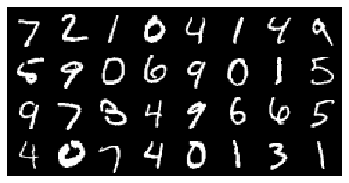

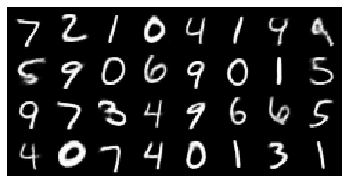

In [31]:
# VAE Tests
# TAs will change these paths as you will have provided the model files manually
"""To TAs, you should have been creating a folder with the student uid
   And the .ipynb + models in the root. Then that path is './VAE_model.pth' etc.
"""
vae = torch.jit.load('./CW_VAE/VAE_model11.pth')
vae.eval()

# Check if VAE is convolutional

for module in vae.children():
    for layer in module.children():
        if "Conv2d" in layer.original_name:
            print("Used Convs")
            break

vae_in = make_grid(vae_denorm(vae_input), nrow=8, padding=2, normalize=False,
                range=None, scale_each=False, pad_value=0)
plt.figure()
plt.axis('off')
show(vae_in)

vae_test = vae(vae_input.to(device))[0].detach()
vae_reco = make_grid(vae_denorm(vae_test), nrow=8, padding=2, normalize=False,
                range=None, scale_each=False, pad_value=0)
plt.figure()
plt.axis('off')
show(vae_reco)

Number of Parameters is 14777344 which is ok


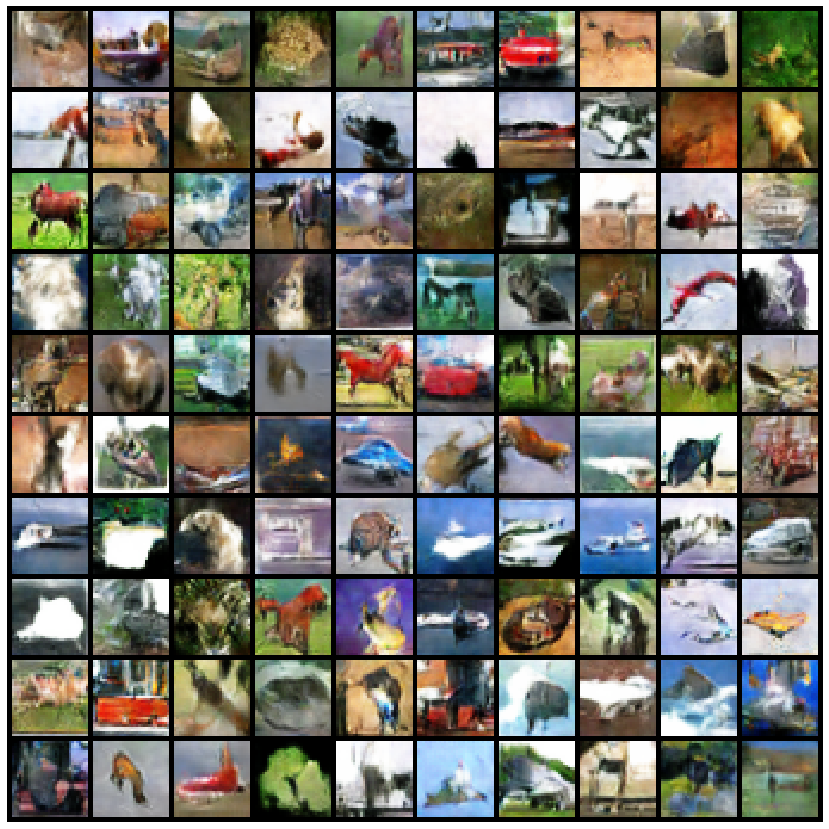

In [24]:
# GAN Tests
!cd /storage/icl_dl_cw2/
model_G = torch.jit.load('./CW_GAN/GAN_G_model.pth')
model_D = torch.jit.load('./CW_GAN/GAN_D_model.pth')
[model.eval() for model in (model_G, model_D)]  

# Check that GAN doesn't have too many parameters
num_param = sum(p.numel() for p in [*model_G.parameters(),*model_D.parameters()])

print(f"Number of Parameters is {num_param} which is", "ok" if num_param<25E+6 else "not ok")

# visualize the generated images
generated = model_G(*gan_input).cpu()
generated = make_grid(gan_denorm(generated)[:100].detach(), nrow=10, padding=2, normalize=False, 
                    range=None, scale_each=False, pad_value=0)
plt.figure(figsize=(15,15))
plt.axis('off')
show(generated)